<a href="https://colab.research.google.com/github/Cirrusfloccus31/diffusion_class/blob/main/Diffusion_TP1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# INSA, GMM Image
## Practical sessions: Introduction to Diffusion

Welcome in this practical session on diffusion models.  
Diffusion models are a class of generative models that have been used to generate images, videos, and audio. They are based on the idea of gradually adding noise to an image and then removing the noise to get back the original image.  
Since the training of diffusion models is computationally expensive, we will use a toy dataset to illustrate the concept of diffusion.  
We will use a 2d points dataset to illustrate the concept of diffusion and then we will apply it to a pretrained image model.  
Let's start by downloading and visualizing the dataset.

In [1]:
!wget https://github.com/tanelp/tiny-diffusion/raw/refs/heads/master/static/DatasaurusDozen.tsv

--2025-01-09 14:02:46--  https://github.com/tanelp/tiny-diffusion/raw/refs/heads/master/static/DatasaurusDozen.tsv
Resolving github.com (github.com)... 20.27.177.113
Connecting to github.com (github.com)|20.27.177.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/tanelp/tiny-diffusion/refs/heads/master/static/DatasaurusDozen.tsv [following]
--2025-01-09 14:02:47--  https://raw.githubusercontent.com/tanelp/tiny-diffusion/refs/heads/master/static/DatasaurusDozen.tsv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.111.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 64046 (63K) [text/plain]
Saving to: ‘DatasaurusDozen.tsv’

DatasaurusDozen.tsv 100%[===================>]  62.54K  --.-KB/s    in 0.08s   

2025-01-09 14:02:47 (776 KB/s) - ‘Datasaurus

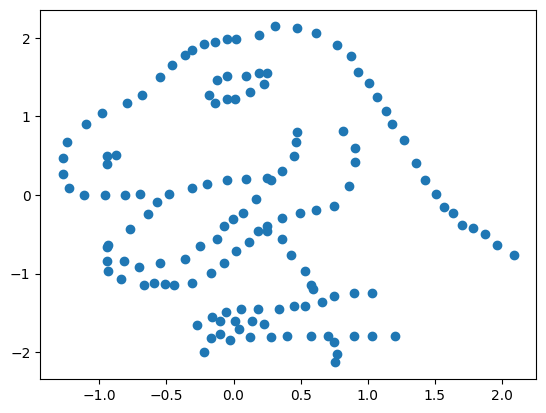

In [2]:
import torch
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from typing import List

device = 'cuda' if torch.cuda.is_available() else 'cpu'

df = pd.read_csv('DatasaurusDozen.tsv',sep='\t')
datasaurus = (np.asarray(df[df['dataset']=='dino'][['x','y']].values, dtype=float))
datasaurus = (datasaurus - datasaurus.mean())/datasaurus.std()
plt.scatter(datasaurus[:,0],datasaurus[:,1])

We will use this dataset to illustrate the concept of diffusion.  
This data will be our initial distribution, the one we want to sample from.  
Since we don't know how to sample from this distribution, we will use a noise schedule to gradually add noise to the data until we reach a Gaussian distribution for which we know how to sample.  
Then we will use the reverse process to sample from the initial distribution.  

### Noise Schedule
Let's begin by defining the noise schedule.  
The noise schedule is a function that defines the amount of noise to add at each timestep.  
We will use a linear schedule for this example.  

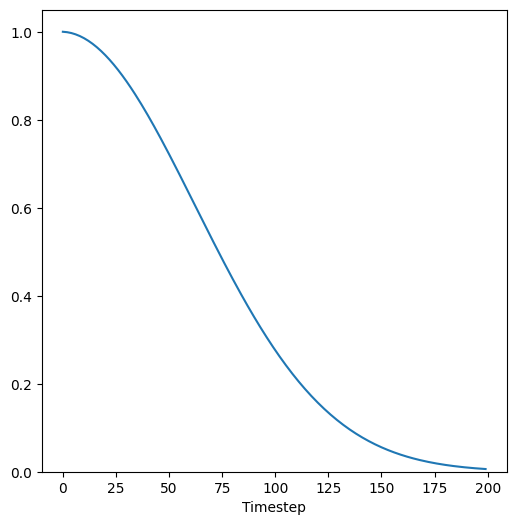

In [3]:
T=200
alpha_min=0.0001
alpha_max=0.05
alphas = torch.linspace(alpha_min, alpha_max, T)
alphas = 1. - alphas
alpha_bar = torch.cumprod(alphas, dim=0)
plt.figure(figsize=[6, 6])
plt.plot(torch.arange(T), alpha_bar)
plt.xlabel('Timestep')
plt.ylim(0,1.05)
plt.show()

### Forward Pass
The forward pass is the process of adding noise to the data at each timestep.  
We will use the noise schedule to define the amount of noise to add at each timestep.  
We saw in class that the forward step can be written as:
$$x_t = \sqrt{\alpha_t}x_{t-1} + \sqrt{1-\alpha_t}\epsilon_t$$
where $\alpha_t$ is the amount of noise to add at timestep $t$ and $\epsilon_t$ is a noise sample.  
Complete the following functions to perform the forward pass.

In [4]:
def forward_step(x_t_minus_1:torch.Tensor, alphas:torch.Tensor, t:int, eps:torch.Tensor) -> torch.Tensor:
    """
    Takes the previous step, the alphas and the timestep and returns the next step
    args:
        x_t_minus_1: the previous step
        alphas: the alphas of the noise schedule
        t: the timestep
        eps: the noise sample
    returns:
        x_t: the next step
    """
    return alphas[t]**0.5 * x_t_minus_1 + (1 - alphas[t])**0.5 * eps

def forward_pass(x_0:torch.Tensor, alphas:torch.Tensor, T:int=200) -> List[torch.Tensor]:
    """
    Takes the initial data, the alphas and the number of timesteps and returns the list of forward steps
    args:
        x_0: the initial data
        alphas: the alphas of the noise schedule
        T: the number of timesteps
    returns:
        x_series: a list of the forward steps
    """
    x_series = [x_0]
    for t in range(T):
        eps = torch.randn_like(x_0)
        x_series.append(forward_step(x_series[-1], alphas, t, eps))
    return x_series

x_0 = torch.tensor(datasaurus).repeat(6, 1) # we repeat the data 6 times to have more points to visualize
x_series = forward_pass(x_0, alphas, T)

In [5]:
x_series[0].shape

torch.Size([852, 2])

Now plot the different steps of the forward pass for t = [0, 6, 12, 25, 50]

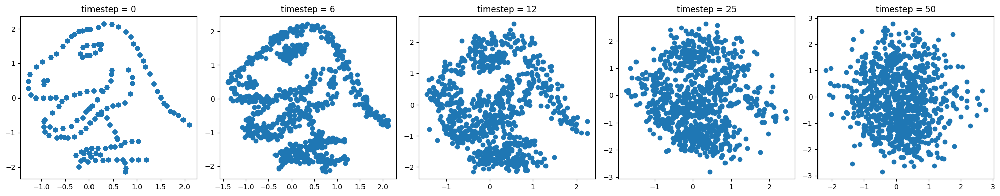

In [6]:
figure = plt.figure(figsize=(20, 4))
for i, t in enumerate([0, 6, 12, 25, 50]):
    figure.add_subplot(1,5,i+1)
    plt.scatter(x_series[t][:, 0], x_series[t][:, 1])
    plt.title(f"timestep = {t}")
plt.tight_layout()
plt.show()

You should observe that the data becomes more and more noisy as the timestep increases.  
The following code animates the forward pass and allows you to see the data evolve over time.


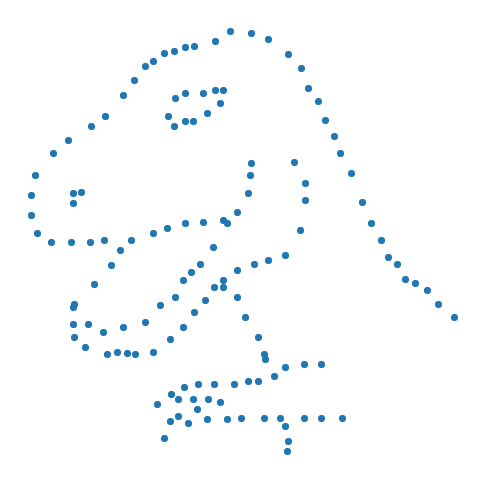

In [7]:
from matplotlib.animation import FuncAnimation
import matplotlib.pyplot as plt
from IPython.display import HTML
from functools import partial

fig, ax = plt.subplots(figsize=(6, 6))

def animate(i:int, series:List[torch.Tensor]):
    ax.clear()
    data = series[i]
    ax.scatter(data[:, 0], data[:, 1], s=15, alpha=0.5)
    ax.set_axis_off()

animate_forward = partial(animate, series=x_series)

anim = FuncAnimation(fig, animate_forward, frames=len(x_series),
                    interval=250)  # 500ms between frames

HTML(anim.to_jshtml())

For training, we would like to have diversity in the training batches, meaning different samples with different timesteps.  
We saw in class that it is to directly noise the data for a given timestep without having to go through the forward pass for all the timesteps.  
$$x_t = \sqrt{\bar{\alpha_t}}x_{0} + \sqrt{1-\bar{\alpha_t}}\epsilon_t$$
Complete the following function to sample the data for a given timestep and verify that it seems correct by plotting the data for t in [0, 6, 12, 25, 50]

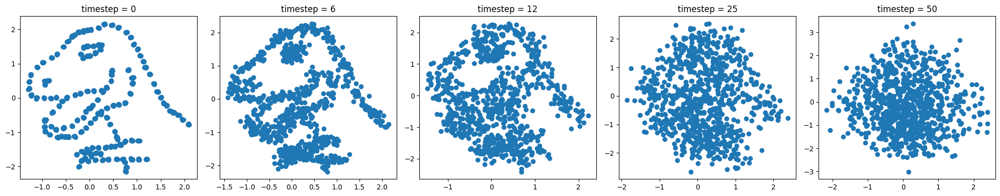

In [8]:
def sample_x_t(x_0:torch.Tensor, t:int, alpha_bar:torch.Tensor, eps:torch.Tensor) -> torch.Tensor:
    """
    Takes the initial data, the alphas and the number of timesteps and returns a noisy version of the data for a given timestep
    args:
        x_0: the initial data
        alphas: the alphas of the noise schedule
        T: the number of timesteps
    returns:
        x_t: a noisy version of the data for a given timestep
    """
    return alpha_bar**0.5 * x_0 + (1 - alpha_bar)**0.5 * eps


figure = plt.figure(figsize=(20, 4))
for i, t in enumerate([0, 6, 12, 25, 50]):
    figure.add_subplot(1,5,i+1)
    eps = torch.randn_like(x_0)
    x_t = sample_x_t(x_0, t, alpha_bar[t], eps)
    plt.scatter(x_t[:, 0], x_t[:, 1])
    plt.title(f"timestep = {t}")
plt.tight_layout()
plt.show()


## Training
We will now train a denoising model to learn the reverse process.  
First, we need to create a dataset with our data.  
### Dataset
We now define a torch dataset to load our data.  We then split the data into a train and test set and create dataloaders for each.  

In [9]:
from torch.utils.data import DataLoader, Dataset, random_split

class DinoDataset(Dataset):
    def __init__(self, data):
        self.data = data

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx].float()

dataset = DinoDataset(x_0)

# Train/Test Split
train_size = int(0.9 * len(dataset))
test_size = len(dataset) - train_size
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])

batch_size = 128
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)


In [10]:
batch = next(iter(train_loader))
print(batch.shape)

torch.Size([128, 2])


### Model:
Now that the dataset and dataloaders are created, we can define the model.  
We will use a simple MLP with 5 layers of 64 neurons each and a final layer to output the predicted noise.
We will use the GELU activation function between each layer.  
Remember that the output of the model will be the predicted noise which has the same dimension as the input.
Complete the following class to define the model.  
Since we will be training the model on the data for different timesteps, we will need to pass the timestep as an additional input to the model.  
We will do this by concatenating the timestep to the input data.  

In [11]:
class Denoisier(torch.nn.Module):
    def __init__(self):
        super().__init__()
        self.model = torch.nn.Sequential(
            torch.nn.Linear(3, 64),
            torch.nn.GELU(),
            torch.nn.Linear(64, 64),
            torch.nn.GELU(),
            torch.nn.Linear(64, 64),
            torch.nn.GELU(),
            torch.nn.Linear(64, 64),
            torch.nn.GELU(),
            torch.nn.Linear(64, 2),
        )


    def forward(self, x:torch.Tensor, t:torch.Tensor) -> torch.Tensor:
        # Concatenate the timestep to the input data
        return self.model(torch.cat([x, t], dim=1))

### Training loop:
At this point, we have all the components to train the model.  
The training loop of a denoising model is actually quite simple.  
Look at the training algorithm from the paper and implement the training loop.  
![training_loop](https://github.com/Cirrusfloccus31/diffusion_class/blob/main/images/training.png?raw=1)


In [12]:
from tqdm.notebook import tqdm # you can use tqdm to display a progress bar

def train(model:torch.nn.Module, train_dataloader:DataLoader, optimizer:torch.optim.Optimizer, alpha_bar:torch.Tensor, epochs:int=50, device:str='cpu'):
    train_loss = []
    alpha_bar = alpha_bar.to(device)
    for epoch in tqdm(range(epochs)):
        running_loss = 0.0
        for x in train_dataloader:
            optimizer.zero_grad()
            x = x.to(device)
            eps = torch.randn_like(x, device=device)
            t = torch.randint(0, T, (x.shape[0],1), device=device)
            x_t = sample_x_t(x, t, alpha_bar[t], eps)
            pred_noise = model(x_t, t)
            loss = torch.nn.functional.mse_loss(pred_noise, eps, reduction="sum")
            running_loss += loss.item()
            loss.backward()
            optimizer.step()
        train_loss.append(running_loss / len(train_dataloader.dataset))
    return train_loss

### Training:
Now instantiate the model and optimizer (Adam with a learning rate of 1e-3) and train the model for 3000 epochs.  

In [13]:
model = Denoisier()
model = model.to(device)# don't forget to move the model to the correct device
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
train_loss = train(model, train_loader, optimizer, alpha_bar, epochs=3000, device=device)

  0%|          | 0/3000 [00:00<?, ?it/s]

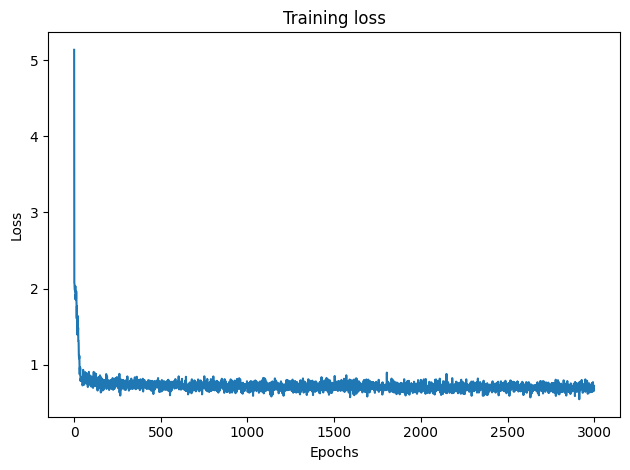

In [14]:
fig = plt.figure()
plt.plot(train_loss)
plt.title("Training loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.tight_layout()
plt.show()

### Sampling:
Here is the moment of truth!
We will now sample from the model and see if we did manage to learn the reverse process.  
Remember that the sampling algorithm is the following:  
![](https://github.com/Cirrusfloccus31/diffusion_class/blob/main/images/sampling.png?raw=1)  
Use it to complete the following function.  Once this is done, use it to sample 1000 points and plot them.  

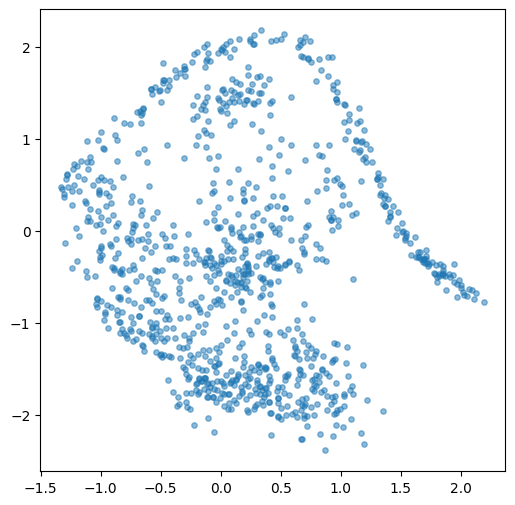

In [15]:
@torch.no_grad()
def sample(num_samples:int, model:torch.nn.Module, alpha:torch.Tensor, alpha_bar:torch.Tensor, T:int=200, device:str='cpu') -> List[torch.Tensor]:
    """
    Takes the model, the alphas and the number of timesteps and returns a list of the sampled data for each timestep
    args:
        model: the denoising model
        alphas: the alphas of the noise schedule
        T: the number of timesteps
    returns:
        x_series: a list of the sampled data for each timestep
    """
    alpha = alpha.to(device)
    alpha_bar = alpha_bar.to(device)
    steps = []
    xt = torch.randn((num_samples, 2)).to(device)
    for t in reversed(range(T)):
        t_batch = torch.full((num_samples, 1), t).to(device)
        noise_pred = model(xt, t_batch)
        mu_hat_t = (xt - (1-alpha[t,None])/(1-alpha_bar[t,None]).sqrt()*noise_pred)/(alpha[t,None]).sqrt()

        z = torch.randn_like(xt).to(device)
        sigma = (1.-alpha[t]).sqrt()
        xt = mu_hat_t + sigma*z
        steps.append(xt.clone().detach().to('cpu'))
    return steps

steps = sample(1000, model, alphas, alpha_bar, T=T, device=device)
plt.figure(figsize=[6, 6])
plt.scatter(steps[-1][:,0],steps[-1][:,1],s=15,alpha=0.5)

We are getting there! But we can do better. Even if the model would probably have converged if we trained it for longer, for now let's try to train faster and better.  
### Time embedding:
We will now try to improve the model by adding a time embedding.  
This is a common technique in diffusion models to help the model learn the temporal aspect of the data.  
We will use a simple sinusoidal position embedding.  

In [16]:
import math

class SinusoidalPositionEmbeddings(torch.nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        embeddings = math.log(10000) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        return embeddings



Now, complete the following class to define the model with the time embedding and train it for 2000 epochs.  

In [17]:
class DenoisierWithTimeEmbedding(torch.nn.Module):
    def __init__(self, t_emb_dim=32, device='cpu'):
        super().__init__()
        self.time_embedder = SinusoidalPositionEmbeddings(t_emb_dim)
        self.layers = torch.nn.Sequential(
            torch.nn.Linear(2 + t_emb_dim, 64),
            torch.nn.GELU(),
            torch.nn.Linear(64, 64),
            torch.nn.GELU(),
            torch.nn.Linear(64, 64),
            torch.nn.GELU(),
            torch.nn.Linear(64, 64),
            torch.nn.GELU(),
            torch.nn.Linear(64, 2),
        )

    def forward(self, x, t):
        t_emb = self.time_embedder(t.squeeze(1))
        x = torch.cat((x, t_emb), dim=1)
        return self.layers(x)

model = DenoisierWithTimeEmbedding().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
train_loss = train(model, train_loader, optimizer, alpha_bar, epochs=3000, device=device)

  0%|          | 0/3000 [00:00<?, ?it/s]

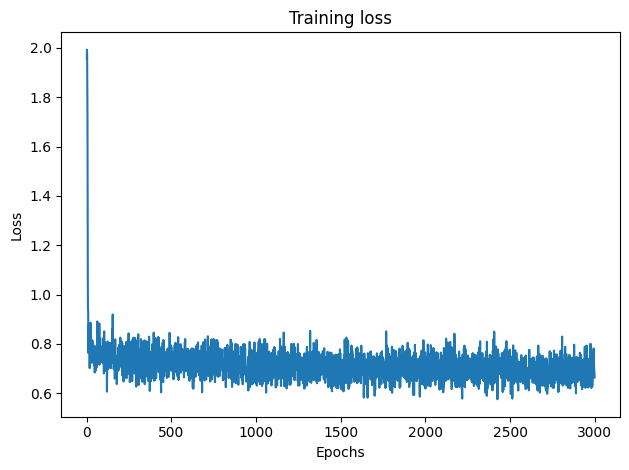

In [18]:
fig = plt.figure()
plt.plot(train_loss)
plt.title("Training loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.tight_layout()
plt.show()

Sample 1000 new points and plot them.

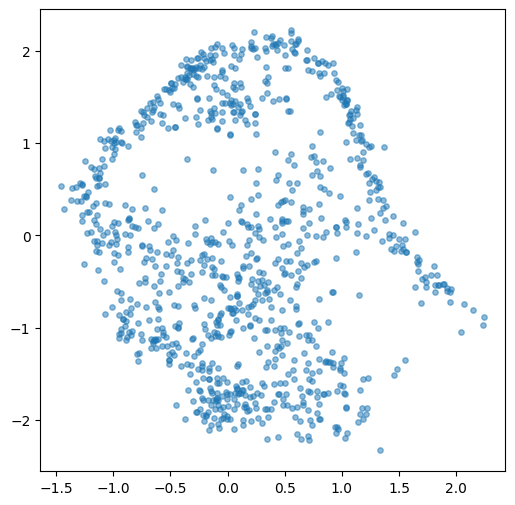

In [19]:
steps = sample(1000, model, alphas, alpha_bar, T=T, device=device)
plt.figure(figsize=[6, 6])
plt.scatter(steps[-1][:,0],steps[-1][:,1],s=15,alpha=0.5)

Using the previous code, make a small animation to visualize the sampling process.

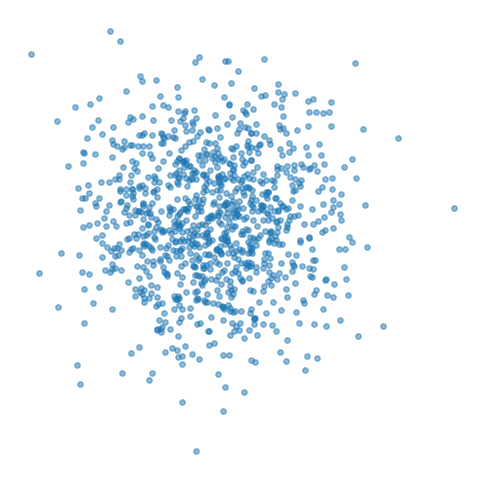

In [20]:
fig, ax = plt.subplots(figsize=(6, 6))

animate_backward = partial(animate, series=steps)

anim = FuncAnimation(fig, animate_backward, frames=len(steps),
                    interval=250)  # 500ms between frames

HTML(anim.to_jshtml())

## Image models
In the previous part, we have seen how to train an unconditional diffusion model to generate samples from a target distribution.  
We did it on a 2d example, but in practice, diffusion models are often used to generate more structured data like images or audio.  
In this part, we will see how to use a pretrained text2image model to generate images from text.  
We will use the [diffusers](https://github.com/huggingface/diffusers) library to load a pretrained model and generate images of faces.  

In [21]:
from diffusers import UNet2DModel

repo_id = "google/ddpm-celebahq-256" # "google/ddpm-church-256"
model = UNet2DModel.from_pretrained(repo_id)

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:104: UserWarning: 
Error while fetching `HF_TOKEN` secret value from your vault: 'Requesting secret HF_TOKEN timed out. Secrets can only be fetched when running from the Colab UI.'.
You are not authenticated with the Hugging Face Hub in this notebook.
If the error persists, please let us know by opening an issue on GitHub (https://github.com/huggingface/huggingface_hub/issues/new).
  warnings.warn(


config.json:   0%|          | 0.00/790 [00:00<?, ?B/s]

An error occurred while trying to fetch google/ddpm-celebahq-256: google/ddpm-celebahq-256 does not appear to have a file named diffusion_pytorch_model.safetensors.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


diffusion_pytorch_model.bin:   0%|          | 0.00/455M [00:00<?, ?B/s]

The architecture of the neural network, referred to as **model**, commonly follows the UNet architecture as proposed in [this paper](https://arxiv.org/abs/1505.04597) and improved upon in the Pixel++ paper.

![](https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/unet-model.png)

We can start by loading the model and checking its configuration in particular to know what is its input shape.

In [22]:
model.config

FrozenDict([('sample_size', 256),
            ('in_channels', 3),
            ('out_channels', 3),
            ('center_input_sample', False),
            ('time_embedding_type', 'positional'),
            ('time_embedding_dim', None),
            ('freq_shift', 1),
            ('flip_sin_to_cos', False),
            ('down_block_types',
             ['DownBlock2D',
              'DownBlock2D',
              'DownBlock2D',
              'DownBlock2D',
              'AttnDownBlock2D',
              'DownBlock2D']),
            ('up_block_types',
             ['UpBlock2D',
              'AttnUpBlock2D',
              'UpBlock2D',
              'UpBlock2D',
              'UpBlock2D',
              'UpBlock2D']),
            ('block_out_channels', [128, 128, 256, 256, 512, 512]),
            ('layers_per_block', 2),
            ('mid_block_scale_factor', 1),
            ('downsample_padding', 0),
            ('downsample_type', 'conv'),
            ('upsample_type', 'conv'),
            ('

Generate a random input for the model of shape (1, 3, 256, 256)

In [23]:
noisy_sample = torch.randn(
    1, model.config.in_channels, model.config.sample_size, model.config.sample_size
)
noisy_sample.shape

torch.Size([1, 3, 256, 256])

The following code does a noise prediction at for a given timestep and a given noisy image.

In [24]:
with torch.no_grad():
    noisy_residual = model(sample=noisy_sample, timestep=2).sample
noisy_residual.shape

torch.Size([1, 3, 256, 256])

diffusers pretrained models come with a scheduler, responsible for the noise schedule.  
Here is the corresponding scheduler

In [25]:
from diffusers import DDPMScheduler

scheduler = DDPMScheduler.from_config(repo_id)
scheduler.config

/usr/local/lib/python3.10/dist-packages/diffusers/configuration_utils.py:245: FutureWarning: It is deprecated to pass a pretrained model name or path to `from_config`.If you were trying to load a scheduler, please use <class 'diffusers.schedulers.scheduling_ddpm.DDPMScheduler'>.from_pretrained(...) instead. Otherwise, please make sure to pass a configuration dictionary instead. This functionality will be removed in v1.0.0.
  deprecate("config-passed-as-path", "1.0.0", deprecation_message, standard_warn=False)


scheduler_config.json:   0%|          | 0.00/256 [00:00<?, ?B/s]

FrozenDict([('num_train_timesteps', 1000),
            ('beta_start', 0.0001),
            ('beta_end', 0.02),
            ('beta_schedule', 'linear'),
            ('trained_betas', None),
            ('variance_type', 'fixed_small'),
            ('clip_sample', True),
            ('prediction_type', 'epsilon'),
            ('thresholding', False),
            ('dynamic_thresholding_ratio', 0.995),
            ('clip_sample_range', 1.0),
            ('sample_max_value', 1.0),
            ('timestep_spacing', 'leading'),
            ('steps_offset', 0),
            ('rescale_betas_zero_snr', False),
            ('_use_default_values',
             ['thresholding',
              'prediction_type',
              'sample_max_value',
              'steps_offset',
              'clip_sample_range',
              'dynamic_thresholding_ratio',
              'timestep_spacing',
              'rescale_betas_zero_snr']),
            ('_class_name', 'DDPMScheduler'),
            ('_diffusers_versi

Knowing that $\bar{\alpha_t}$ is the cumulative product of the alphas where $\alpha = 1 - \beta$, we can compute the $\bar{\alpha_t}$ and plot them.  

(0.0, 1.05)

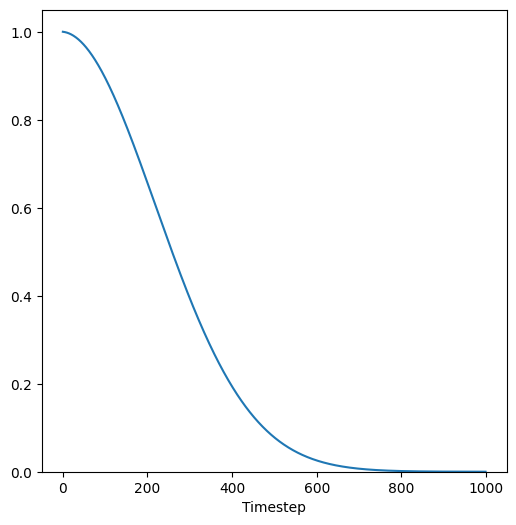

In [26]:
T=1000
beta_min=0.0001
beta_max=0.02
betas = torch.linspace(beta_min, beta_max, T)
alphas = 1. - betas
alpha_bar = torch.cumprod(alphas, dim=0)
plt.figure(figsize=[6, 6])
plt.plot(torch.arange(T), alpha_bar)
plt.xlabel('Timestep')
plt.ylim(0,1.05)

Let's visualize the noise schedule applied to an image.  

In [27]:
!wget https://www.soinsdebene.com/wp-content/uploads/2015/10/visage-femme-noire1.jpg -O image.jpg

--2025-01-09 14:06:05--  https://www.soinsdebene.com/wp-content/uploads/2015/10/visage-femme-noire1.jpg
Resolving www.soinsdebene.com (www.soinsdebene.com)... 162.251.80.25
Connecting to www.soinsdebene.com (www.soinsdebene.com)|162.251.80.25|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 33023 (32K) [image/jpeg]
Saving to: ‘image.jpg’

image.jpg           100%[===================>]  32.25K   201KB/s    in 0.2s    

2025-01-09 14:06:08 (201 KB/s) - ‘image.jpg’ saved [33023/33023]



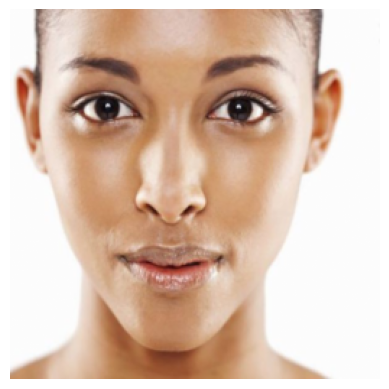

In [28]:
from PIL import Image
from torchvision import transforms
x_0 = Image.open("image.jpg")

mean = [ 0.485, 0.456, 0.406 ]
std = [ 0.229, 0.224, 0.225 ]
normalize = transforms.Normalize(mean, std)
inv_normalize = transforms.Normalize(
   mean= [-m/s for m, s in zip(mean, std)],
   std= [1/s for s in std]
)

transform = transforms.Compose([transforms.Resize((256, 256)),
                                transforms.ToTensor(),
                                normalize])
x_0 = transform(x_0)

def tensor_to_img(img):
    if len(img.shape) == 4:
        img = img.squeeze(0)
    img = inv_normalize(img)
    img = img.permute(1, 2, 0)
    return img

img = tensor_to_img(x_0)
plt.imshow(img)
plt.axis('off')
plt.show()

We need to modify a little bit the sampling function to make it compatible with image inputs.  

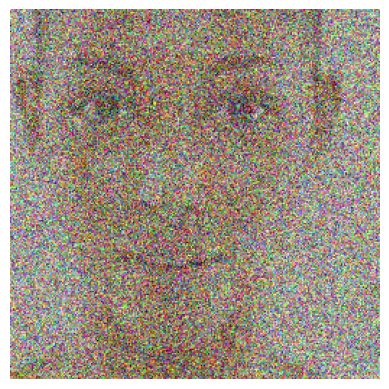

In [29]:
def sample_x_t(x_0, t, alpha_bar, eps):
    return alpha_bar[t, None, None, None].sqrt()*x_0 + (1.-alpha_bar[t, None, None , None]).sqrt()*eps

eps = torch.randn_like(x_0)
t = 500
x_t = sample_x_t(x_0, t, alpha_bar, eps)
img = tensor_to_img(x_t)
plt.imshow(img)
plt.axis('off')
plt.show()

Look at the mean and std of the image of a noisysample at time step 999. What would you expect and is it what you observe?

Mean = 0.010754592716693878 std = 1.0001306533813477


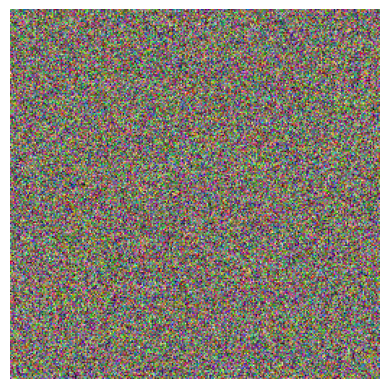

In [30]:
eps = torch.randn_like(x_0)
t = 999
x_t = sample_x_t(x_0, t, alpha_bar, eps)
img = tensor_to_img(x_t)
print("Mean =", torch.mean(x_t).item(), "std =", torch.std(x_t).item())
plt.imshow(img)
plt.axis('off')
plt.show()

Let's look at the evolution of the image at several timestep.

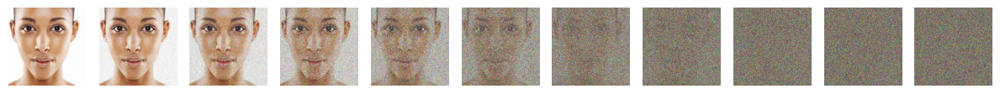

In [31]:
plt.figure(figsize=[12, 6])
for i, t in enumerate([0, 100, 200, 300, 400, 500, 600, 700, 800, 900, 999]):
    eps = torch.randn_like(x_0)
    x_t = sample_x_t(x_0, t, alpha_bar, eps)
    plt.subplot(1, 11, i+1)
    plt.imshow(tensor_to_img(x_t))
    plt.axis('off')
    #tight layout
    plt.tight_layout()
plt.show()

Let's now try to generate an image from a text prompt given the noise schedule previously computed and our previous sampling function.  
Let's define a new sampling function which is compatible with `diffusers` unet. No need here to store the intermediate steps.  

In [36]:
from tqdm.notebook import tqdm
import torch

model = model.to(device)
@torch.no_grad()
def sample(num_samples, model, alpha, alpha_bar, T=200, device=device):
    alpha = alpha.to(device)
    alpha_bar = alpha_bar.to(device)
    xt = noisy_sample = torch.randn(
        1, model.config.in_channels, model.config.sample_size, model.config.sample_size
    ).to(device)
    for t in reversed(range(T)):
        t_batch = torch.full((num_samples,), t).to(device)
        noise_pred = model(xt, t_batch).sample
        mu_hat_t = (xt - (1-alpha[t,None])/(1-alpha_bar[t,None]).sqrt()*noise_pred)/(alpha[t,None]).sqrt()

        z = torch.randn_like(xt).to(device)
        sigma = (1.-alpha[t]).sqrt()
        xt = mu_hat_t + sigma*z
    return xt

x_0 = sample(1, model, alphas, alpha_bar, T=1000)

Plot the generated image.   

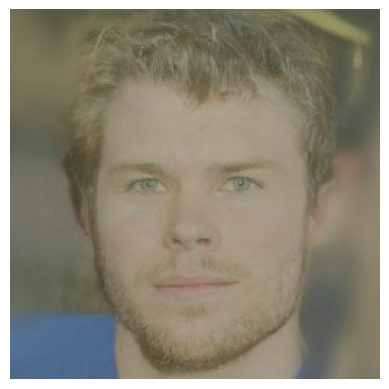

In [37]:
img = tensor_to_img(x_0[0].cpu())
plt.imshow(img)
plt.axis('off')
plt.show()